In [1]:
import numpy as np
import xgcm
from xgcm import Grid
from xhistogram.xarray import histogram
import xarray as xr
import xroms
from scipy import signal
import glob
import functions #the .py file that contains all the relevant functions
from datetime import datetime

import warnings
import cartopy
import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature
import cmocean.cm as cmo
import matplotlib.pyplot as plt
from matplotlib import ticker
from matplotlib.dates import DateFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.rcParams.update({'font.size': 12})

import warnings
warnings.filterwarnings("ignore")
from celluloid import Camera
from IPython.display import HTML

In [282]:
# svarhr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/svar/*.nc')
# salthr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/salt/*.nc')
# volhr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/vol/*.nc')

# xr.merge([svarhr, salthr, volhr]).to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/histograms/Qcombh_2010.nc')
# xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/Qcombh_2010.nc')
# ds = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/Qcombh_2010.nc') #Change the path if necessary
# ds = functions.exchange_flow(ds)

# ds.to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_2010_hourly_highres.nc')
# ds = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/*.nc') #Change the path if necessary
# ds = functions.exchange_flow(ds)

# ds.attrs['Description'] = 'Exchange flow Dataset'
# ds.attrs['Author'] = 'Dylan Schlichting'
# ds.attrs['Created'] = datetime.now().isoformat()
# ds.attrs['Grid'] = 'xi points: '+str(xislice)+', eta points: '+str(etaslice)

# ds.to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_hourly_2010.nc', engine = 'h5netcdf')
# print('Exchange flow saved')

### Open the following netcdf files: Dissipation of salinity variance, storage terms, tef, river forcing, surface forcing, and TXLA model output

In [2]:
chi = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/chi_hourly_2010_highres.nc').chi
storage = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/storage_hourly_2010.nc')
tef = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_2010_hourly_highres.nc')

path = '/scratch/user/dylan.schlichting/TXLA_Outputs/parent/2010/forcing/txla2_river_2010_AR_newT_SWpass_weekly.nc'
riverds = xr.open_dataset(path).sel(river_time = '2010') #for some reason the last day of 2009 is here, needs to be trimmed
streamflow = np.abs(riverds.river_transport).sum('river')

path = '/scratch/user/dylan.schlichting/TXLA_Outputs/parent/2010/forcing/txla_bulk_ERAI_2010.nc'
surfaceds = xr.open_dataset(path).sel(time = '2010')

paths = glob.glob('../../../dylan.schlichting/TXLA_Outputs/parent/2010/ocean_his_00*.nc')

ds = xroms.open_mfnetcdf(paths, 
                         chunks = {'ocean_time':1})
ds, grid = xroms.roms_dataset(ds, 
                              Vtransform = None)

xislice=slice(260,381) 
etaslice=slice(47,149)

#Surface fluxes
swflux = surfaceds.swflux.isel(eta_rho = etaslice, xi_rho = xislice,) \
                         .resample(time = '1h').interpolate('linear')[:-1]
 
swflux = swflux.rename({'time':'ocean_time'})

#convert units & slice
ep = ((swflux/100)/86400).load() #cm/d to m/s

dA = ds.dA.isel(eta_rho = etaslice, xi_rho = xislice,)

epda = (ep*dA).sum(['eta_rho','xi_rho'])

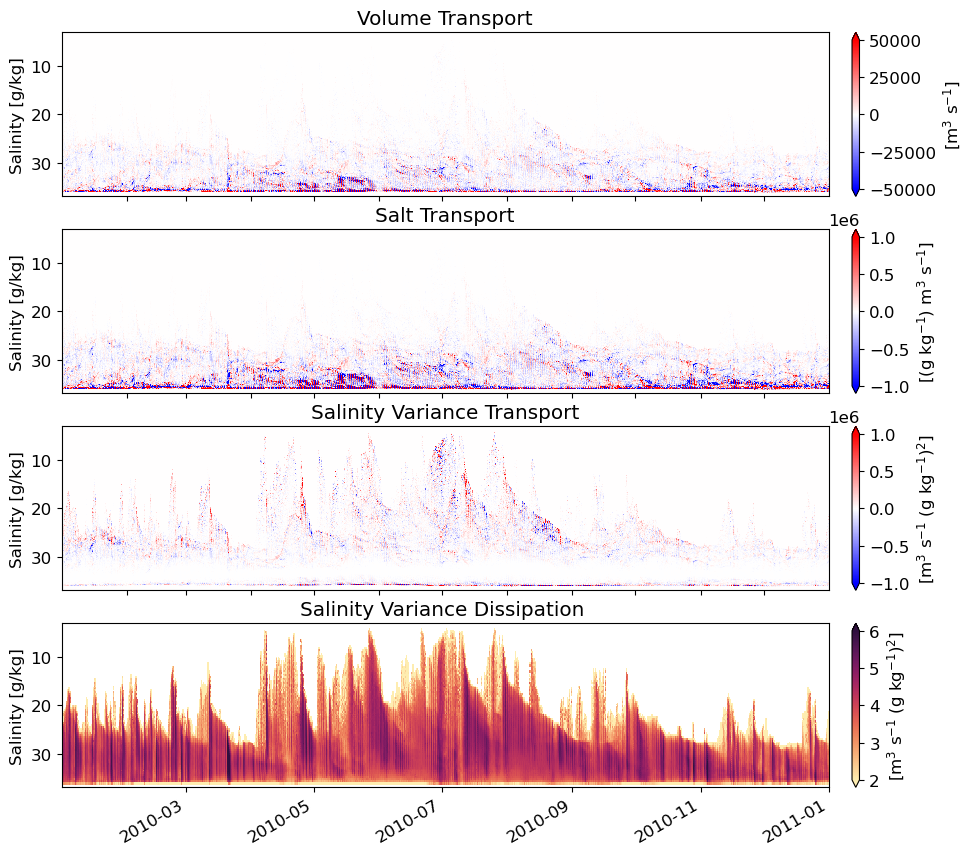

In [284]:
fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100)

(tef.Qnet).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '[m$^3$ s$^{-1}$]',
                               'pad': 0.025},
                vmax = 0.5E5
               )
(tef.Qsnet).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '[(g kg$^{-1}$) m$^3$ s$^{-1}$]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )
(tef.Qsvarnet).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )

np.log10(chi).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmin = 2, vmax = 6
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
    
ax[0].set_title('Volume Transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title('Salt Transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title('Salinity Variance Transport')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Salinity Variance Dissipation ')
ax[3].invert_yaxis()

### Let's attempt to normalize this by plotting dQ^c/ds

In [6]:
salt_bins = np.linspace(0, 40, 501)
ds = salt_bins[1]-salt_bins[0]

In [7]:
dQds = tef.Qnet.diff('salt_bin')/ds
dQsds = tef.Qsnet.diff('salt_bin')/ds
dQsvards = tef.Qsvarnet.diff('salt_bin')/ds

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


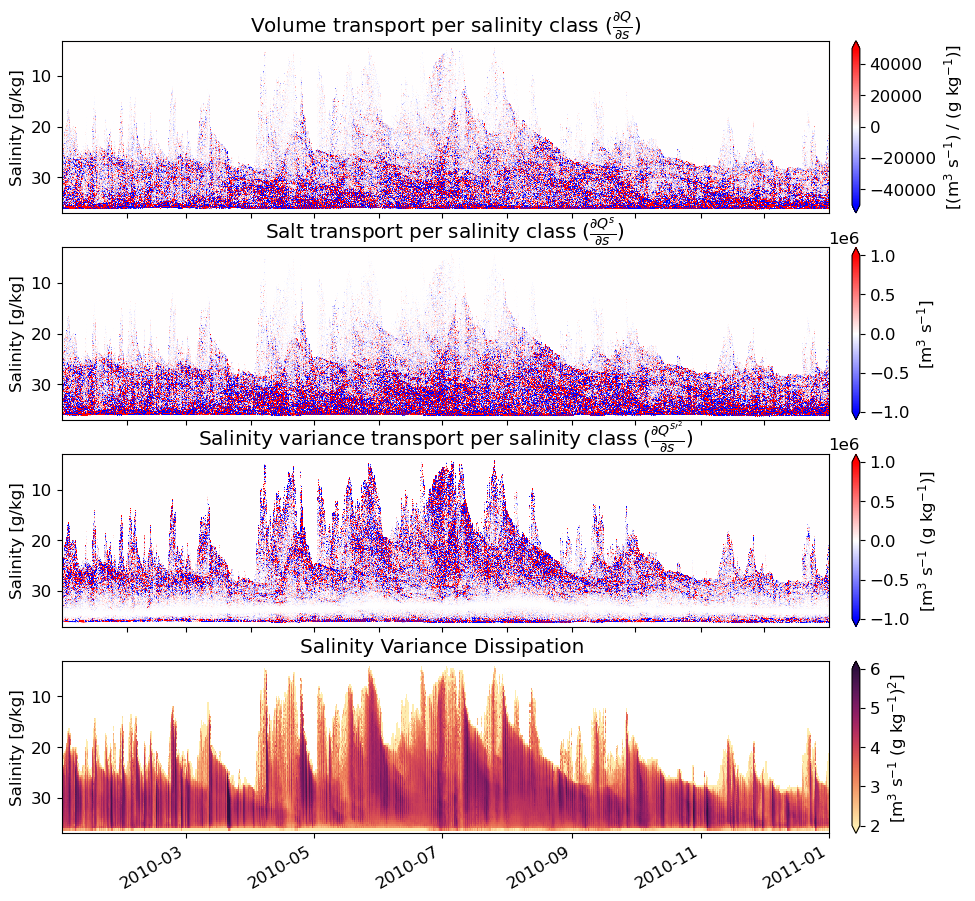

In [8]:
fig, ax = plt.subplots(4,1, figsize = (12,10.5), dpi = 100)

(dQds).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '[(m$^3$ s$^{-1}$) / (g kg$^{-1}$)]',
                               'pad': 0.025},
                vmax = 0.5E5
               )
(dQsds).plot(y = 'salt_bin', 
                 cmap = plt.get_cmap('bwr'),
                 ax = ax[1],
                 cbar_kwargs = {'label': '[m$^3$ s$^{-1}$]',
                                 'pad': 0.025},
                 vmax = 1e6
                   )
(dQsvards).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )

np.log10(chi).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmin = 2, vmax = 6
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
    
ax[0].set_title(r'Volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Salt transport per salinity class ($\frac{\partial Q^s}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Salinity Variance Dissipation ')
ax[3].invert_yaxis()

### Investigate different normalization schemes. First, try dividing each value by the maximum flux in that particular salinity class.

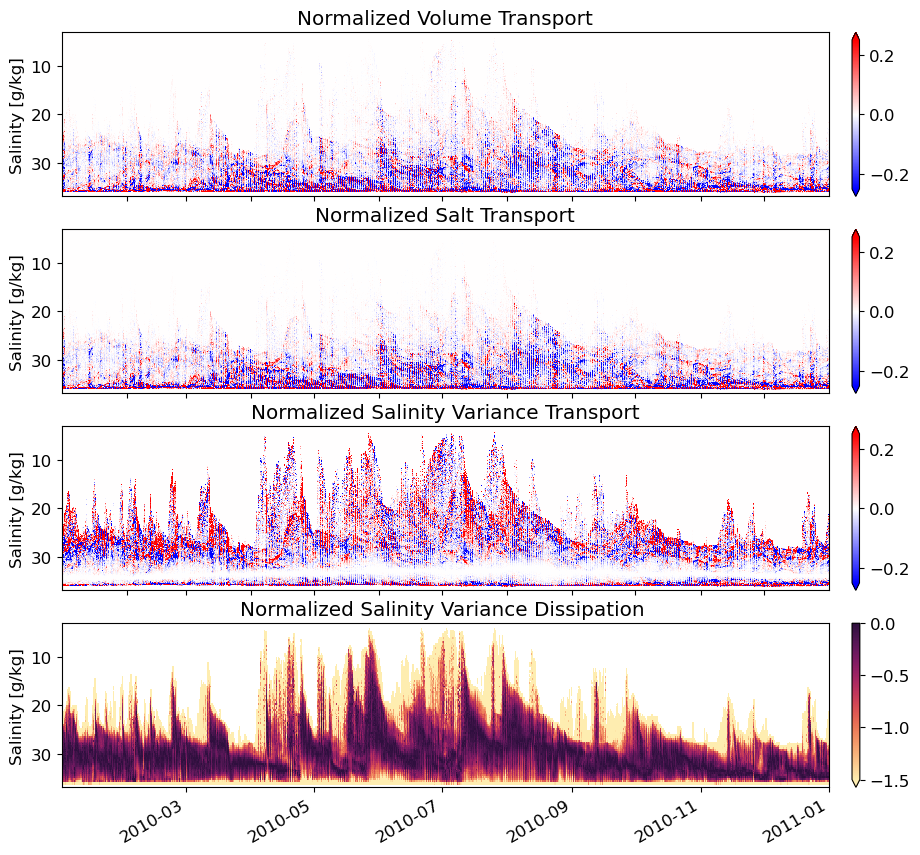

In [291]:
fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100)

(tef.Qnet/np.abs(tef.Qnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.25, vmax = .25
               )
(tef.Qsnet/np.abs(tef.Qsnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )
(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title('Normalized Volume Transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title('Normalized Salt Transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title('Normalized Salinity Variance Transport')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Normalized Salinity Variance Dissipation ')
ax[3].invert_yaxis()

(0.0, 50000.0)

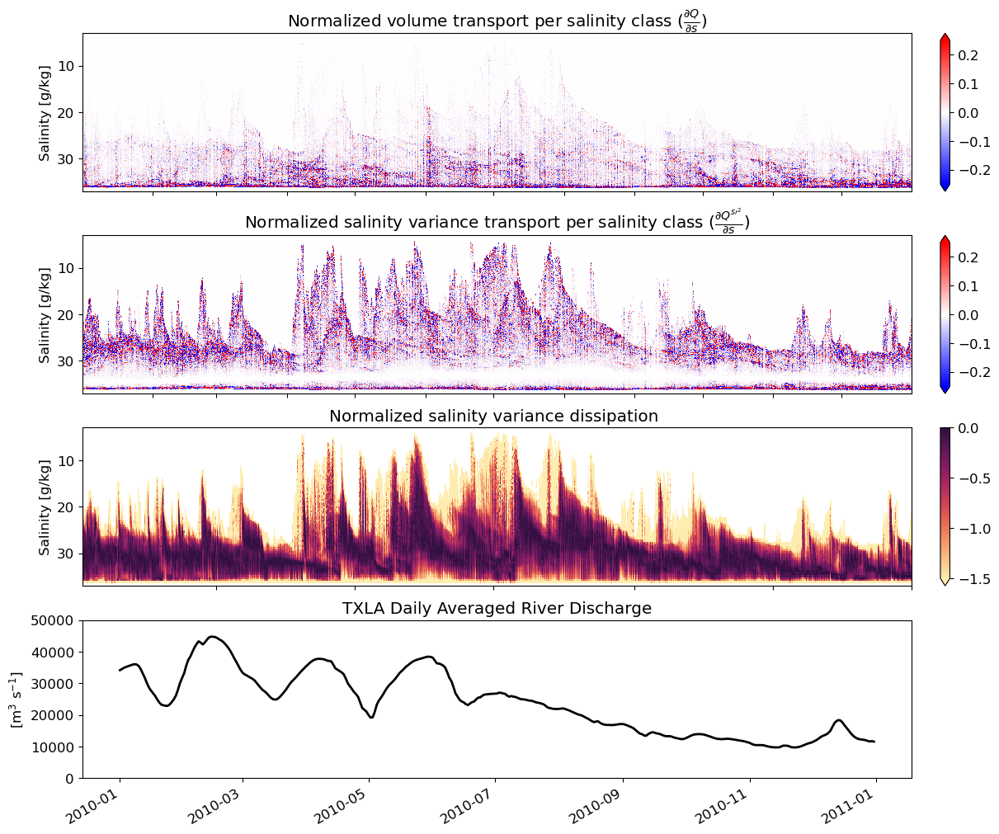

In [293]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100, constrained_layout = True)


(dQds/np.abs(dQds.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.25, vmax = .25
               )
(dQsvards/np.abs(dQsvards.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )

streamflow.plot(ax = ax[3], lw = 2, c = 'k')

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()


ax[2].set_title(r'Normalized salinity variance dissipation ')
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_title(r'TXLA Daily Averaged River Discharge')
ax[3].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[3].set_ylim(0, 50000)


In [1]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)


(tef.Qnet/np.abs(tef.Qnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.1, vmax = .1
               )
(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.1, vmax = .1
                   )

(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.amp,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

# streamflow.plot(ax = ax[3], lw = 2, c = 'k')

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()
# ax[2].axes.xaxis.set_ticklabels([])

# ax[3].set_title(r'TXLA Daily Averaged River Discharge')
# ax[3].set_ylabel(r'[m$^3$ s$^{-1}$]')
# ax[3].set_ylim(0, 50000)

ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)


ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

NameError: name 'plt' is not defined

### Start looking at the surface fluxes

In [18]:
swflux = surfaceds.swflux.isel(eta_rho = etaslice, xi_rho = xislice,) \
                         .resample(time = '1h').interpolate('linear')[:-1]
 
swflux = swflux.rename({'time':'ocean_time'})

#convert units & slice
ep = ((swflux/100)/86400).load() #cm/d to m/s

dA = ds.dA.isel(eta_rho = etaslice, xi_rho = xislice,)

epda = (ep*dA).sum(['eta_rho','xi_rho'])

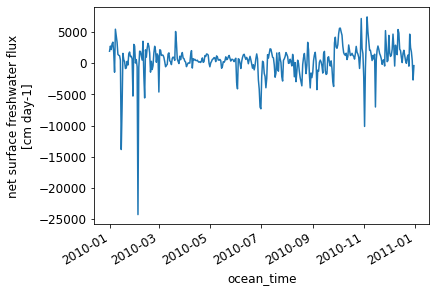

In [19]:
ep_daily = epda.resample(ocean_time = 'D').mean()
ep_daily.plot()

NameError: name 'ep_daily' is not defined

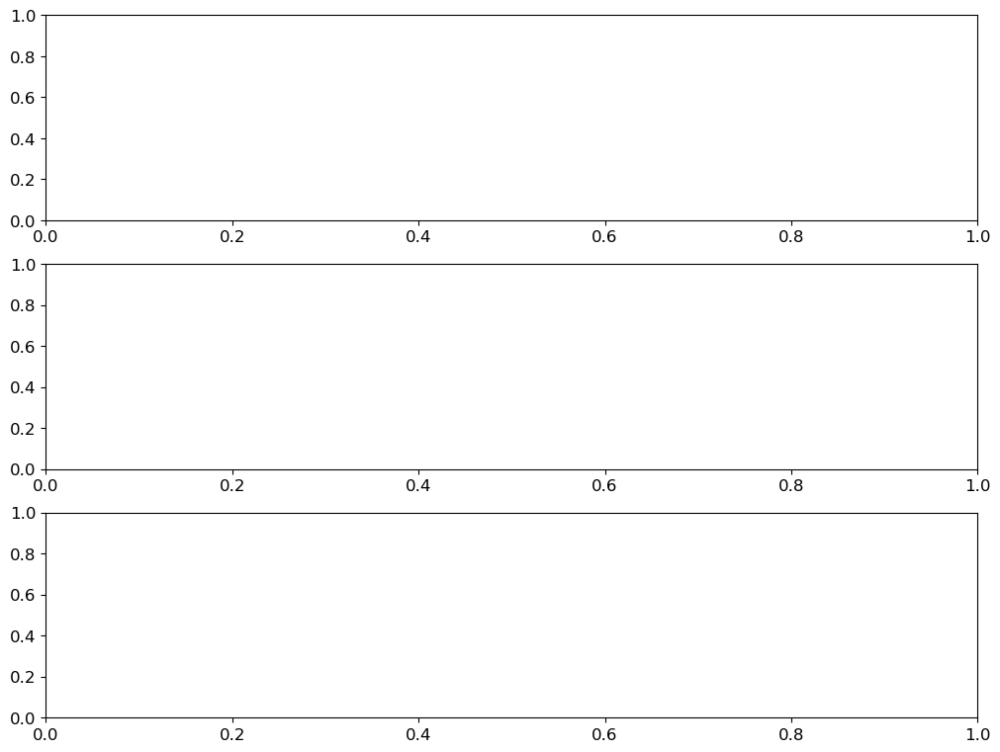

In [16]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(3,1, figsize = (10,7.5), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[2],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].set_title(r'Normalized salinity variance transport')
ax[2].invert_yaxis()
ax[2].set_xlabel('')

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)

ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

In [21]:
uwind = xroms.to_rho(surfaceds.Uwind, grid).isel(eta_rho = etaslice, xi_rho = xislice) \
                         .resample(time = '1h').interpolate('linear')[:-1]
vwind = xroms.to_rho(surfaceds.Vwind, grid).isel(eta_rho = etaslice, xi_rho = xislice) \
                         .resample(time = '1h').interpolate('linear')[:-1]

stresstot = xr.ufuncs.sqrt(uwind**2+vwind**2).mean(['eta_rho', 'xi_rho']).load()

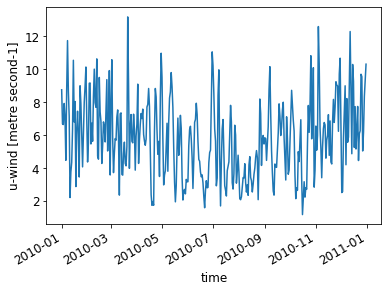

In [22]:
stressd = stresstot.resample(time = 'D').mean()
stressd.plot()

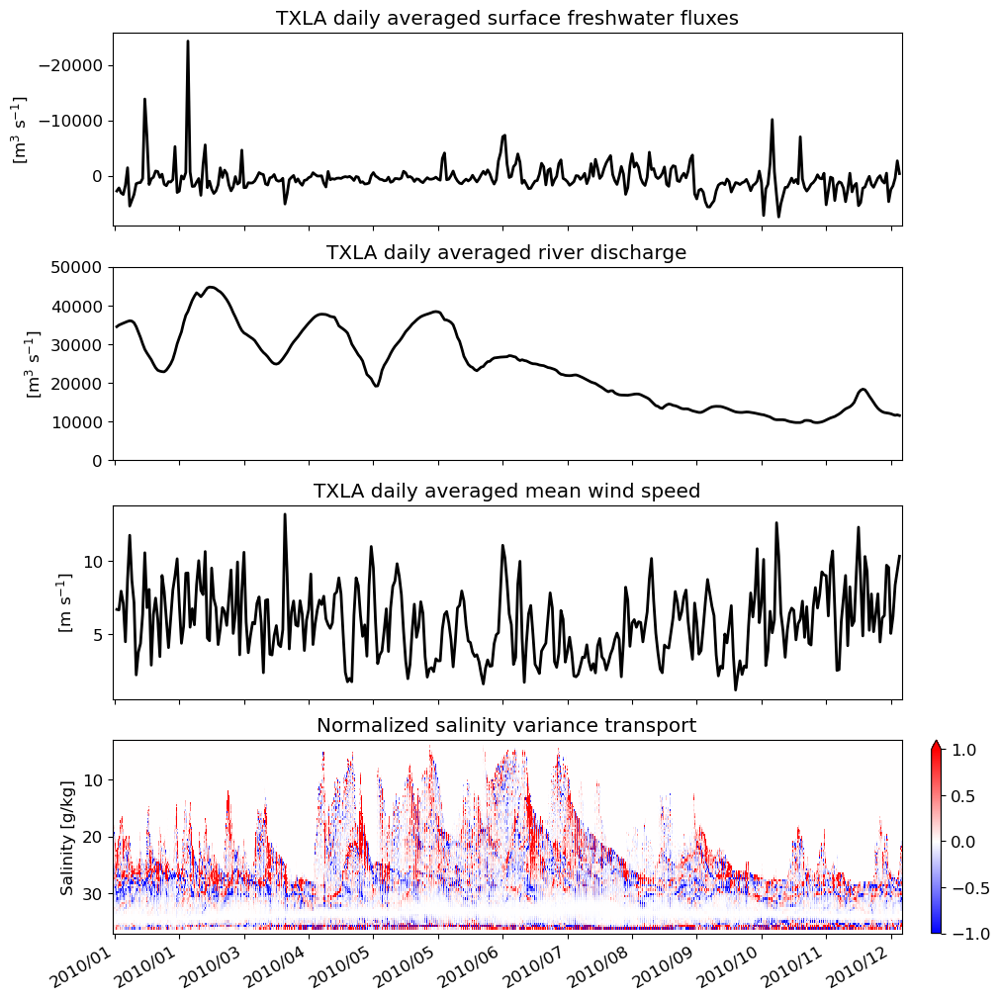

In [272]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,10), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-06', '2010-08')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-06', '2010-08')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

stressd.sel(time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[2], lw = 2, c = 'k')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_title('TXLA daily averaged mean wind speed')
ax[2].set_ylabel('[m s$^{-1}$]')
ax[2].set_xlabel('')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)
ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2010--31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')
ax[3].set_xlim('2009-12-31', '2011-01-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


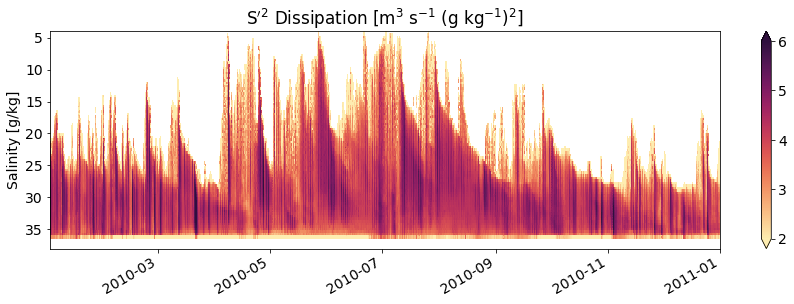

In [22]:
fig, ax = plt.subplots(1, figsize = (15,4))

np.log10(chi).plot(y = 'salt_bin', 
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': ''},
                    vmin = 2, vmax = 6
             )

ax.set_xlabel('')
ax.set_ylabel('Salinity [g/kg]')
ax.set_ylim(4,38)
ax.set_title(r'S$^\prime{^2}$ Dissipation [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]')
ax.invert_yaxis()

Text(0.5, 1.0, 'Daily Averaged TXLA River Discharge')

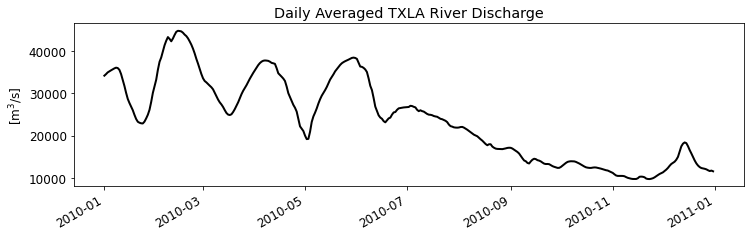

In [119]:
fig, ax = plt.subplots(1, figsize = (12,3))
streamflow.plot(lw = 2, c = 'k')
plt.xlabel('')
plt.ylabel('[m$^3$/s]')
plt.title('Daily Averaged TXLA River Discharge')

In [ ]:
chidaily = chi.sum('salt_bin').resample(ocean_time = 'D').mean().sel(ocean_time = '2010')

In [ ]:
dVdt_da = storage.dVdt.resample(ocean_time = 'D').mean()
storage = storage.assign(dVdt_da = storage.dVdt.resample(ocean_time = 'D').mean())

In [ ]:
dVdt_da.plot()

In [ ]:
storage.dVdt_da.plot()

## Look at seasonal differences. Start with summer 

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


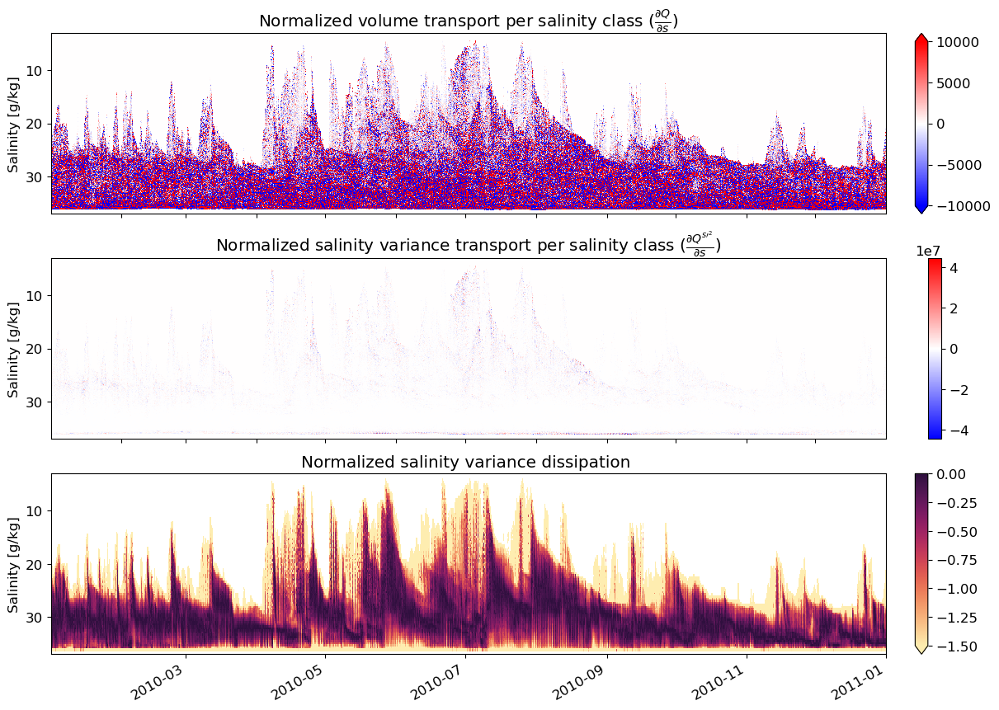

In [41]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8.5), dpi = 100, constrained_layout = True)


(dQds).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmax = 1e4
               )
(dQsvards).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )
for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()


ax[2].set_title(r'Normalized salinity variance dissipation ')
ax[2].invert_yaxis()
# ax[2].axes.xaxis.set_ticklabels([])

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


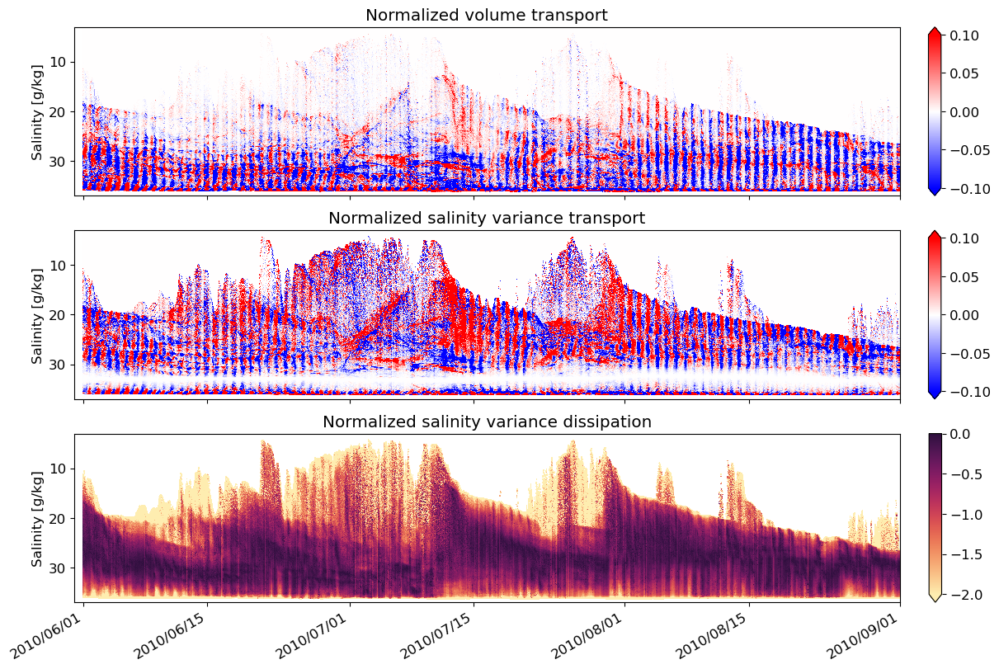

In [15]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)


(tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08'))/np.abs(tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08')).min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.1, vmax = .1
               )
(tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08'))/np.abs(tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08')).min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.1, vmax = .1
                   )

np.log10(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -2, vmax = 0
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()

# M = 10
# xticks = ticker.MaxNLocator(M)

# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
ax[2].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [48]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,10), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

stressd.sel(time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[2], lw = 2, c = 'k')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_title('TXLA daily averaged mean wind speed')
ax[2].set_ylabel('[m s$^{-1}$]')
ax[2].set_xlabel('')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)
ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')
ax[3].set_xlim('2009-12-31', '2011-01-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

<xarray.DataArray 'chi' (ocean_time: 8760, salt_bin: 500)>
[4380000 values with dtype=float64]
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-01-01T01:00:00 ... 2011-01-01
  * salt_bin    (salt_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96

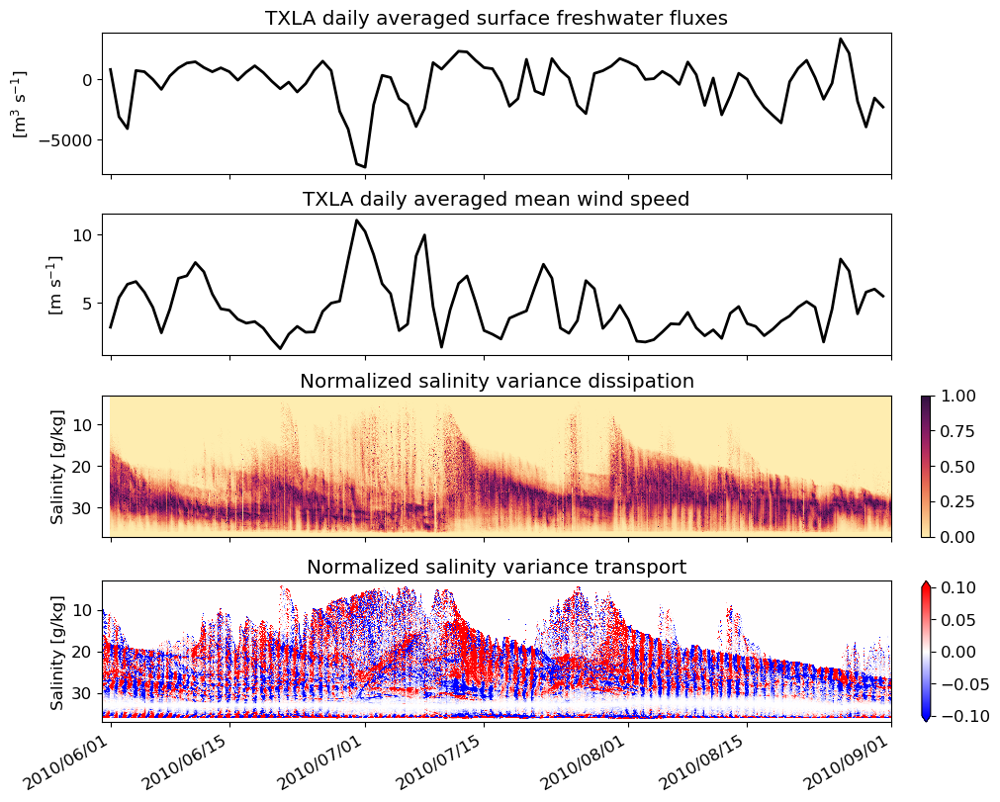

In [33]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,8), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-06', '2010-08')).plot(ax = ax[0], lw = 2, c = 'k')

ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].set_xlabel('')

stressd.sel(time = slice('2010-06', '2010-08')).plot(ax = ax[1], lw = 2, c = 'k')

ax[1].set_title('TXLA daily averaged mean wind speed')
ax[1].set_ylabel('[m s$^{-1}$]')
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])
ax[2].set_xlabel('')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, vmax = .1
                   )



ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

# M = 7
# xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
# ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')
ax[3].set_xlim('2010-05-31', '2010-09-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

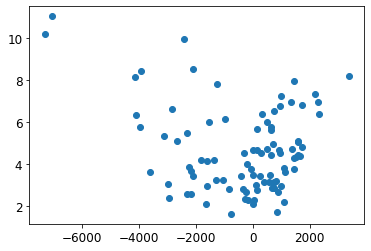

In [34]:
plt.scatter(ep_daily.sel(ocean_time = slice('2010-06', '2010-08')), stressd.sel(time = slice('2010-06', '2010-08')))

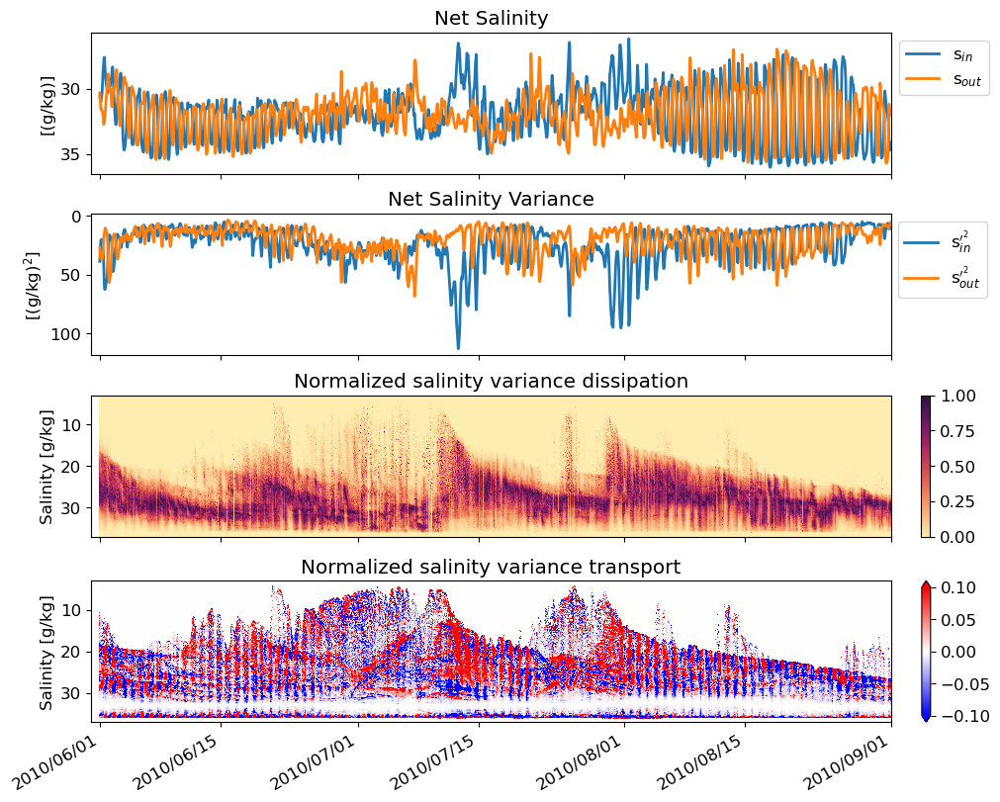

In [84]:
fig, ax = plt.subplots(4, figsize = (10,8), dpi = 100, constrained_layout = True)

tef.sin.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[0], label = 's$_{in}$')
tef.sout.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[0], label = 's$_{out}$')

ax[0].set_xlabel('')
ax[0].set_ylabel(r'[(g/kg)]')
ax[0].set_title('Net Salinity')
ax[0].axes.xaxis.set_ticklabels([])

tef.svarin.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[1], label = 's$_{in}^{\prime^2}$')
tef.svarout.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[1], label = 's$_{out}^{\prime^2}$')

ax[1].set_title('Net Salinity Variance')
ax[1].set_ylabel(r'[(g/kg)$^2$]')
ax[1].set_xlabel('')
ax[0].legend(bbox_to_anchor=(1.0, 1.00))
ax[1].legend(bbox_to_anchor=(1.13, 1.00))
ax[0].invert_yaxis()
ax[1].invert_yaxis()
ax[1].axes.xaxis.set_ticklabels([])

(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])
ax[2].set_xlabel('')

test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, 
                     vmax = .1)


ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()
ax[3].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')
ax[3].set_xlim('2010-05-31', '2010-09-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [76]:
test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, 
                     vmax = .1)

## Remove the inertial signal from the tracer fluxes. Start with a simple rolling mean

In [14]:
volw = tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()
Qsvarw = tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()
chiw = chi.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()

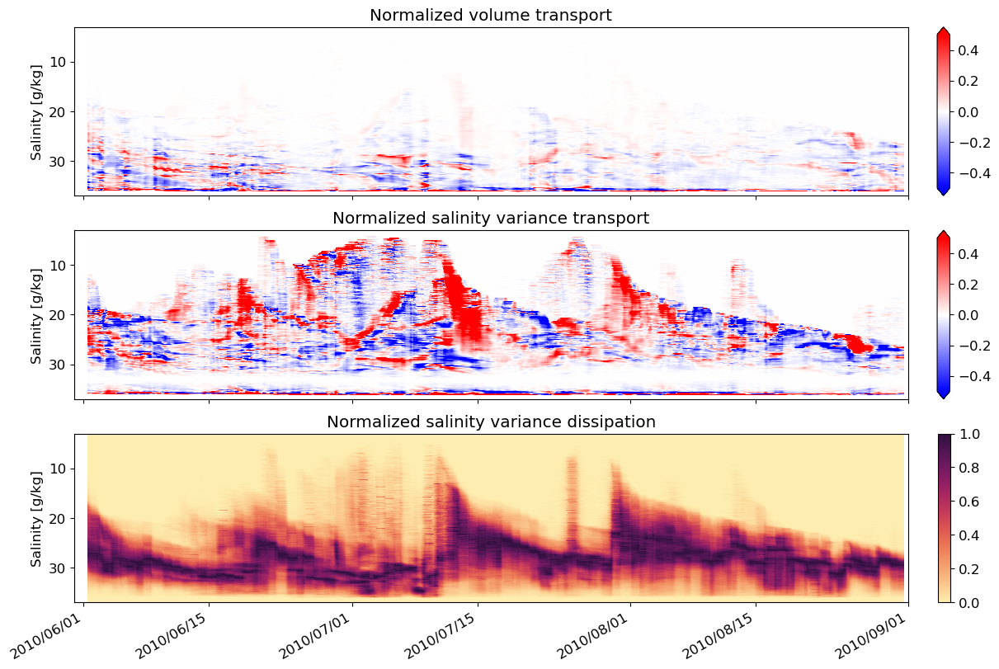

In [15]:
fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)

(volw/(np.abs(volw).max(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                                                cmap = plt.get_cmap('bwr'),
                                                ax = ax[0],
                                                cbar_kwargs = {'label': '',
                                               'pad': 0.025},
                                                vmin = -.5, vmax = .5
               )
(Qsvarw/np.abs(Qsvarw.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.5, vmax = .5
                   )

(chiw/(chiw.max(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()
ax[2].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

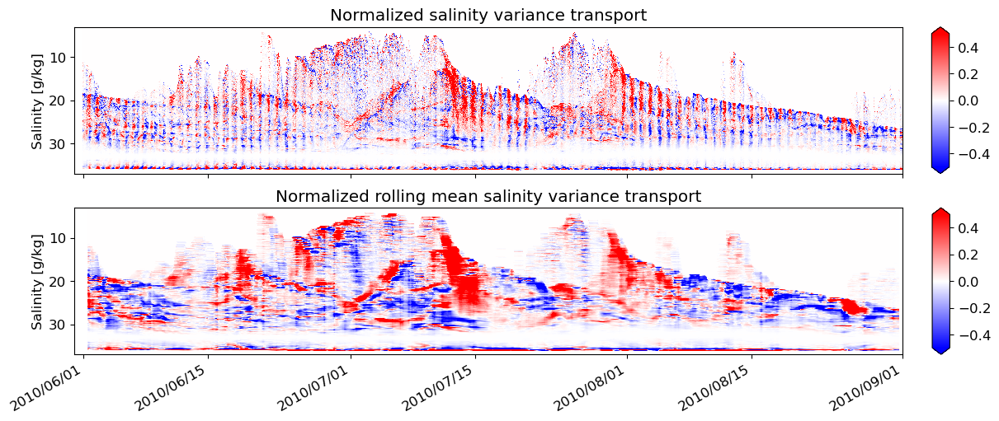

In [104]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(2,1, figsize = (12,5), dpi = 100, constrained_layout = True)

test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[0],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.5, 
                     vmax = .5)

(Qsvarw/np.abs(Qsvarw.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.5, vmax = .5
                   )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized salinity variance transport')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].set_title(r'Normalized rolling mean salinity variance transport')

ax[0].invert_yaxis()
ax[1].invert_yaxis()

# M = 10
# xticks = ticker.MaxNLocator(M)

# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
ax[1].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')

ax[1].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [19]:
volslice = tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08'))
Qsvarslice = tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08'))
chislice = chi.sel(ocean_time = slice('2010-06', '2010-08'))

In [24]:
import scipy

In [ ]:
scipy.ndimage.median_filter(volslice

In [17]:


volw = volslice.rolling(ocean_time = 25*1, center = True).mean()
Qsvarw = Qsvarslice.rolling(ocean_time = 25*1, center = True).mean()
chiw = chislice.rolling(ocean_time = 25*1, center = True).mean()

In [22]:
volslice.weighted(wgts24)

ValueError: `weights` must be a DataArray

In [25]:
tef

<xarray.Dataset>
Dimensions:     (ocean_time: 8759, salt_bin: 500)
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-01-01T01:00:00 ... 2010-12-3...
  * salt_bin    (salt_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96
Data variables:
    Qnet        (ocean_time, salt_bin) float64 ...
    Qin         (ocean_time) float64 ...
    Qout        (ocean_time) float64 ...
    Qsnet       (ocean_time, salt_bin) float64 ...
    Qsin        (ocean_time) float64 ...
    Qsout       (ocean_time) float64 ...
    Qsvarnet    (ocean_time, salt_bin) float64 ...
    Qsvarin     (ocean_time) float64 ...
    Qsvarout    (ocean_time) float64 ...
    sin         (ocean_time) float64 ...
    sout        (ocean_time) float64 ...
    svarin      (ocean_time) float64 ...
    svarout     (ocean_time) float64 ...
    voladv      (ocean_time) float64 ...
    saltadv     (ocean_time) float64 ...
    svaradv     (ocean_time) float64 ...

Text(0.5, 1.0, 'Normalized Salt Variance Dissipation')

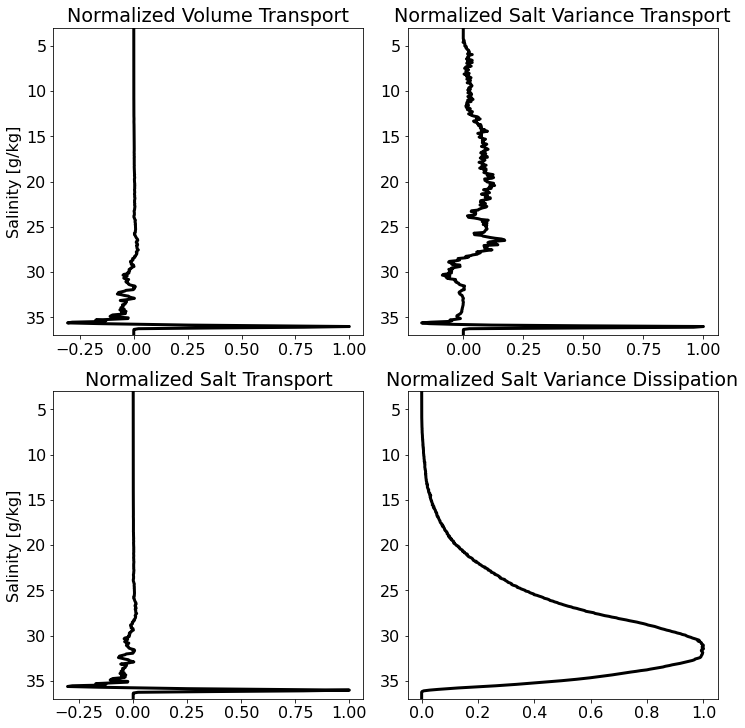

In [57]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(2,2 ,figsize = (10,10), constrained_layout = True)


Qnorm = (tef.Qnet.sum('ocean_time')/(tef.Qnet.sum('ocean_time').max()))
Qnorm.plot(ax = ax[0,0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0,0].invert_yaxis()
ax[0,0].set_xlabel('')
ax[0,0].set_title('Normalized Volume Transport')
ax[0,0].set_ylabel('Salinity [g/kg]')

Qsnorm = (tef.Qsnet.sum('ocean_time')/(tef.Qsnet.sum('ocean_time').max()))
Qsnorm.plot(ax = ax[1,0], 
            y = 'salt_bin', 
            ylim = (3,37),
            c = 'k',
            lw = 3)

ax[1,0].invert_yaxis()
ax[1,0].set_xlabel('')
ax[1,0].set_title('Normalized Salt Transport')
ax[1,0].set_ylabel('Salinity [g/kg]')

Qsvarnorm = (tef.Qsvarnet.sum('ocean_time')/(tef.Qsvarnet.sum('ocean_time').max()))
Qsvarnorm.plot(ax = ax[0,1], 
               y = 'salt_bin', 
               ylim = (3,37),
               c = 'k',
               lw = 3)

ax[0,1].invert_yaxis()
ax[0,1].set_xlabel('')
ax[0,1].set_ylabel('')
ax[0,1].set_title('Normalized Salt Variance Transport')

chinorm = (chi.sum('ocean_time')/(chi.sum('ocean_time').max()))
chinorm.plot(ax = ax[1,1], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[1,1].invert_yaxis()
ax[1,1].set_xlabel('')
ax[1,1].set_ylabel('')
ax[1,1].set_title('Normalized Salt Variance Dissipation')

In [67]:
Qsvarslice

<xarray.DataArray 'Qsvarnet' (ocean_time: 2208, salt_bin: 500)>
[1104000 values with dtype=float64]
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-06-01 ... 2010-08-31T23:00:00
  * salt_bin    (salt_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96

Text(0.5, 1.0, 'Salt Variance Transport')

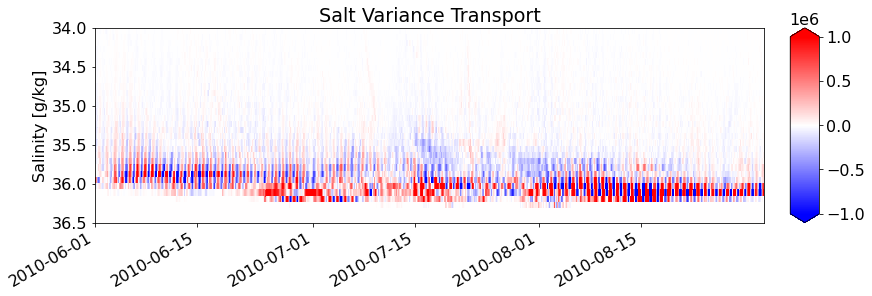

In [88]:
fig, ax = plt.subplots(1,1, figsize = (12,4), constrained_layout = True)


Qsvarslice.plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmax = 1e6)
ax.set_ylim(34,36.5)
ax.invert_yaxis()
ax.set_xlabel('')
ax.set_ylabel('Salinity [g/kg]')
ax.set_title('Salt Variance Transport')

<xarray.Dataset>
Dimensions:         (eta_rho: 191, eta_v: 190, ocean_time: 8760, s_rho: 30, s_w: 31, tracer: 6, xi_rho: 671, xi_u: 670)
Coordinates:
  * s_rho           (s_rho) float64 -0.9833 -0.95 -0.9167 ... -0.05 -0.01667
  * s_w             (s_w) float64 -1.0 -0.9667 -0.9333 ... -0.06667 -0.03333 0.0
    lon_rho         (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
    lat_rho         (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
    lon_u           (eta_rho, xi_u) float64 dask.array<chunksize=(191, 670), meta=np.ndarray>
    lat_u           (eta_rho, xi_u) float64 dask.array<chunksize=(191, 670), meta=np.ndarray>
    lon_v           (eta_v, xi_rho) float64 dask.array<chunksize=(190, 671), meta=np.ndarray>
    lat_v           (eta_v, xi_rho) float64 dask.array<chunksize=(190, 671), meta=np.ndarray>
    lon_psi         (eta_v, xi_u) float64 dask.array<chunksize=(190, 670), meta=np.ndarray>
    lat_psi         (eta_v, xi_u) float64 dask.array<chunksize=(190, 670), meta=np.ndarray>
  * ocean_time      (ocean_time) datetime64[ns] 2010-01-01T01:00:00 ... 2011-...
  * xi_rho          (xi_rho) int64 0 1 2 3 4 5 6 ... 664 665 666 667 668 669 670
  * xi_u            (xi_u) int64 0 1 2 3 4 5 6 7 ... 663 664 665 666 667 668 669
  * eta_rho         (eta_rho) int64 0 1 2 3 4 5 6 ... 185 186 187 188 189 190
  * eta_v           (eta_v) int64 0 1 2 3 4 5 6 ... 183 184 185 186 187 188 189
    z_w             (ocean_time, s_w, eta_rho, xi_rho) float64 dask.array<chunksize=(1, 31, 191, 671), meta=np.ndarray>
    z_w_u           (ocean_time, s_w, eta_rho, xi_u) float64 dask.array<chunksize=(1, 31, 191, 670), meta=np.ndarray>
    z_w_v           (ocean_time, s_w, eta_v, xi_rho) float64 dask.array<chunksize=(1, 31, 190, 671), meta=np.ndarray>
    z_w_psi         (ocean_time, s_w, eta_v, xi_u) float64 dask.array<chunksize=(1, 31, 190, 670), meta=np.ndarray>
    z_rho           (ocean_time, s_rho, eta_rho, xi_rho) float64 dask.array<chunksize=(1, 30, 191, 671), meta=np.ndarray>
    z_rho_u         (ocean_time, s_rho, eta_rho, xi_u) float64 dask.array<chunksize=(1, 30, 191, 670), meta=np.ndarray>
    z_rho_v         (ocean_time, s_rho, eta_v, xi_rho) float64 dask.array<chunksize=(1, 30, 190, 671), meta=np.ndarray>
    z_rho_psi       (ocean_time, s_rho, eta_v, xi_u) float64 dask.array<chunksize=(1, 30, 190, 670), meta=np.ndarray>
    z_rho0          (s_rho, eta_rho, xi_rho) float64 dask.array<chunksize=(30, 191, 671), meta=np.ndarray>
    z_rho_u0        (s_rho, eta_rho, xi_u) float64 dask.array<chunksize=(30, 191, 670), meta=np.ndarray>
    z_rho_v0        (s_rho, eta_v, xi_rho) float64 dask.array<chunksize=(30, 190, 671), meta=np.ndarray>
    z_rho_psi0      (s_rho, eta_v, xi_u) float64 dask.array<chunksize=(30, 190, 670), meta=np.ndarray>
    z_w0            (s_w, eta_rho, xi_rho) float64 dask.array<chunksize=(31, 191, 671), meta=np.ndarray>
    z_w_u0          (s_w, eta_rho, xi_u) float64 dask.array<chunksize=(31, 191, 670), meta=np.ndarray>
    z_w_v0          (s_w, eta_v, xi_rho) float64 dask.array<chunksize=(31, 190, 671), meta=np.ndarray>
    z_w_psi0        (s_w, eta_v, xi_u) float64 dask.array<chunksize=(31, 190, 670), meta=np.ndarray>
Dimensions without coordinates: tracer
Data variables:
    ntimes          int32 ...
    ndtfast         int32 ...
    dt              float64 ...
    dtfast          float64 ...
    dstart          datetime64[ns] ...
    shuffle         int32 ...
    deflate         int32 ...
    deflate_level   int32 ...
    nHIS            int32 ...
    ndefHIS         int32 ...
    nRST            int32 ...
    ntsAVG          int32 ...
    nAVG            int32 ...
    ndefAVG         int32 ...
    ntsDIA          int32 ...
    nDIA            int32 ...
    ndefDIA         int32 ...
    nSTA            int32 ...
    Falpha          float64 ...
    Fbeta           float64 ...
    Fgamma          float64 ...
    nl_tnu2         (tracer) float64 dask.array<chu

## Look at surface forcing animations to study eddies

In [90]:
rv = xroms.relative_vorticity(ds.u, ds.v, ds.u.attrs['grid'])
#Interpolate to the rho points. 
rv = grid.interp(rv, 'Z')

fx = grid.interp(ds.f, 'X', boundary = 'extend')
fxy = grid.interp(fx, 'Y', boundary = 'extend')
RVn = rv/fxy

rvload = RVn.isel(s_rho = -1, eta_v = etaslice, xi_u = xislice).sel(ocean_time = slice('2010-06', '2010-08'))

In [104]:
land_10m = cfeature.NaturalEarthFeature('physical', 'land', '10m',
                                edgecolor='face',
                                facecolor=cfeature.COLORS['land'])
states_provinces = cfeature.NaturalEarthFeature(
                   category='cultural',
                   name='admin_1_states_provinces_lines',
                   scale='10m',
                   facecolor='none')

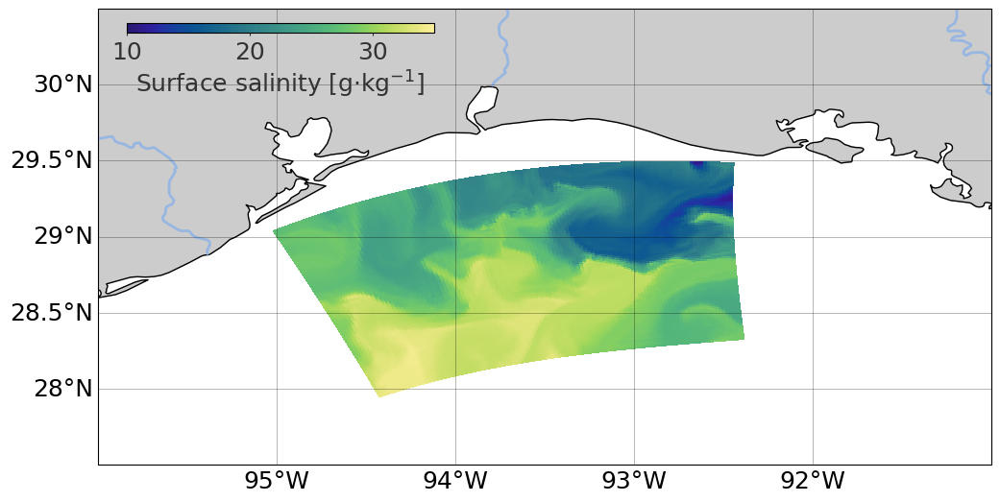

In [184]:
plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(10,5), dpi = 100)
ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))


lon_rho = ds.salt['lon_rho'].isel(eta_rho = etaslice, xi_rho = xislice)
lat_rho = ds.salt['lat_rho'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = -1, eta_rho = etaslice, xi_rho = xislice).sel(ocean_time = slice('2010-06', '2010-08'))

mappable = ax.pcolormesh(lon_rho, lat_rho, sal.sel(), 
                         cmap = cmo.haline, 
                         transform = cartopy.crs.PlateCarree(),
                         vmin = 10, vmax = 35)
gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
#     ax.set_extent([-98, -88, 25, 30.5], ccrs.PlateCarree())
ax.set_extent([-96, -91, 27.5, 30.5], ccrs.PlateCarree())
ax.add_feature(land_10m, facecolor='0.8')
ax.coastlines(resolution='10m')  
ax.add_feature(states_provinces, )
ax.add_feature(cfeature.BORDERS, linestyle='-', )
ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
ax.set_aspect('auto')

cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]',color='0.2')
cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')

#Plot isobaths and label the contours

ax.tick_params(axis='y', labelsize=5)

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.right_labels = False
gl.top_labels = False


In [171]:
plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(8,4), dpi = 100)
camera = Camera(fig)

ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))

lon_rho = ds.salt['lon_rho'].isel(eta_rho = etaslice, xi_rho = xislice)
lat_rho = ds.salt['lat_rho'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = -1, eta_rho = etaslice, xi_rho = xislice).sel(ocean_time = slice('2010-06', '2010-08'))

for time in range(100):
    mappable = ax.pcolormesh(lon_rho, lat_rho, sal[time], 
                             cmap = cmo.haline, 
                             transform = cartopy.crs.PlateCarree(),
                             vmin = 12, vmax = 36)
#     gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
#     ax.set_extent([-98, -88, 25, 30.5], ccrs.PlateCarree())
    ax.set_extent([-96, -91, 27.5, 30.5], ccrs.PlateCarree())
    ax.add_feature(land_10m, facecolor='0.8')
    ax.coastlines(resolution='10m')  
    ax.add_feature(states_provinces, )
    ax.add_feature(cfeature.BORDERS, linestyle='-', )
    ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
    ax.set_aspect('auto')

    cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
    cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
    cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]', color='0.2')
    cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')
    
    #Plot isobaths and label the contours

    ax.tick_params(axis='y', labelsize=13)

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.right_labels = False
    gl.top_labels = False
    camera.snap()
    
animation = camera.animate()
plt.close()
animation.save('test.gif', fps = 20)

In [172]:
from IPython.display import HTML
HTML(animation.to_html5_video())

In [ ]:
plt.rcParams.update({'font.size': 16})
from matplotlib import animation

fig = plt.figure(figsize=(8,4), dpi = 100)
camera = Camera(fig)

ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))

lon_rho = ds.salt['lon_rho'].isel(eta_rho = etaslice, xi_rho = xislice)
lat_rho = ds.salt['lat_rho'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = -1, eta_rho = etaslice, xi_rho = xislice).sel(ocean_time = '2010-06')

def animate(i):
    mappable = ax.pcolormesh(lon_rho, lat_rho, sal[i], 
                             cmap = cmo.haline, 
                             transform = cartopy.crs.PlateCarree(),
                             vmin = 12, vmax = 36)
    ax.set_extent([-96, -91, 27.5, 30.5], ccrs.PlateCarree())
    ax.add_feature(land_10m, facecolor='0.8')
    ax.coastlines(resolution='10m')  
    ax.add_feature(states_provinces, )
    ax.add_feature(cfeature.BORDERS, linestyle='-', )
    ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
    ax.set_aspect('auto')

    cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
    cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
    cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]', color='0.2')
    cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')
    
    #Plot isobaths and label the contours

    ax.tick_params(axis='y', labelsize=13)

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.right_labels = False
    gl.top_labels = False
    
    return mappable
    
anim = animation.FuncAnimation(fig, animate, frames = 200)
anim.save('animation.mp4', writer = 'ffmpeg', fps = 30)

CalledProcessError: Command '['ffmpeg', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '800x400', '-pix_fmt', 'rgba', '-r', '30', '-loglevel', 'error', '-i', 'pipe:', '-vcodec', 'h264', '-pix_fmt', 'yuv420p', '-y', 'animation.mp4']' returned non-zero exit status 255.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Error in callback <function flush_figures at 0x2b0348dfc310> (for post_execute):
Traceback (most recent call last):
  File "/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/IPython/core/events.py", line 89, in trigger
    func(*args, **kwargs)
  File "/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/ipykernel/pylab/backend_inline.py", line 121, in flush_figures
    return show(True)
  File "/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/ipykernel/pylab/backend_inline.py", line 41, in show
    display(
  File "/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/IPython/core/display.py", line 313, in display
    format_dict, md_dict = format(obj, include=include, exclude=exclude)
  File "/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/IPython/core/formatters.py", line 180, in format
    data = formatter(obj)
  File "<decorator-gen-2>",

In [ ]:
fig = plt.figure(figsize=(10,5), dpi = 600)
ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-85.0))

lon = ds.salt['lon_u'].isel(eta_rho = etaslice, xi_rho = xislice)
lat = ds.salt['lat_v'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

mappable = ax.pcolormesh(lon_rho, lat_rho, sal, 
                         cmap = cmo.haline, 
                         transform = cartopy.crs.PlateCarree(),
                         vmin = 15, vmax = 35)

gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
ax.set_extent([-95, -88.5, 28, 30.5], ccrs.PlateCarree())
# ax.set_extent([-94.5, -93.5, 27, 30.5], ccrs.PlateCarree())
ax.add_feature(land_10m, facecolor='0.8')
ax.coastlines(resolution='10m')  
ax.add_feature(states_provinces, )
ax.add_feature(cfeature.BORDERS, linestyle='-', )
ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
ax.set_aspect('auto')

cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
# cb.set_label(r'Surface Salinity [g$\cdot$ kg$^{-1}$]',fontsize=18,  )
cb.set_label(r' Normalized Relative vorticity [s$^{-1}$]',fontsize=18,  )
cb.ax.tick_params(labelsize=18, length=2, color='0.2', labelcolor='0.2')
#Plot isobaths and label the contours
CS = ax.contour(lon_rho, lat_rho, ds.h, hlevs, 
                colors='1', transform=ccrs.PlateCarree(), 
                inline = 1, linewidths=1)

ax.tick_params(axis='y', labelsize=18)
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.right_labels = False
gl.bottom_labels = False

### Calculate entrainment. First, look at the volume integrated quantities and their derivatives in salinity coordinates

In [3]:
volhists = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/entrainment/*.nc').sel(ocean_time = slice('2010-06', '2010-08'))

dVdts = volhists.dV_saltcoord.diff('ocean_time')/3600
dVsdts = volhists.dVs_saltcoord.diff('ocean_time')/3600

Text(0, 0.5, 'Salinity [g/kg]')

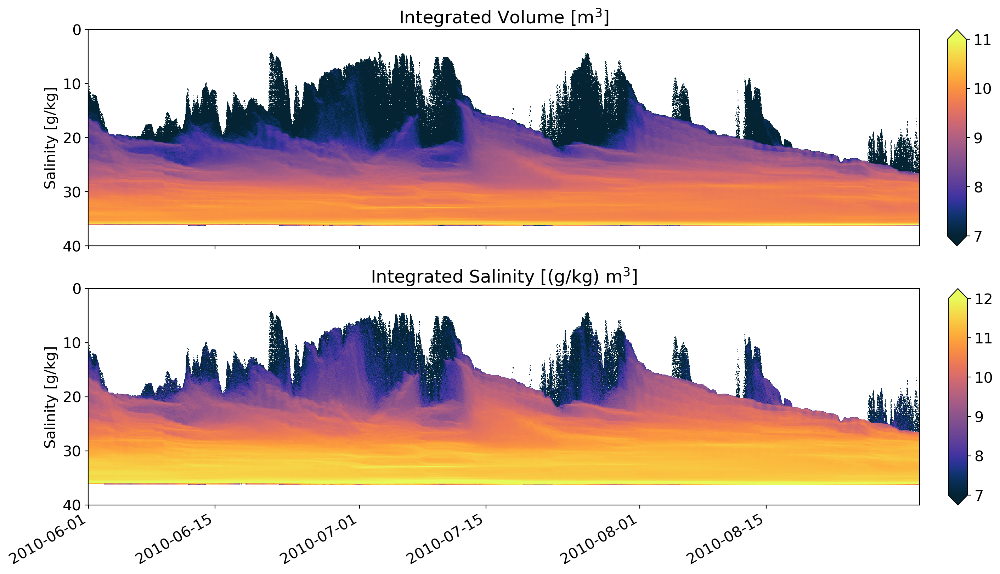

In [24]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

np.log10(volhists.dV_saltcoord).plot(ax = ax[0],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 11,
                                     cbar_kwargs = {'label': '',
                                               'pad': 0.025})

np.log10(volhists.dVs_saltcoord).plot(ax = ax[1],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 12,
                                    cbar_kwargs = {'label': '',
                                               'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Integrated Volume [m$^3$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Integrated Salinity [(g/kg) m$^3$]')
ax[1].set_ylabel('Salinity [g/kg]')

Text(0, 0.5, 'Salinity [g/kg]')

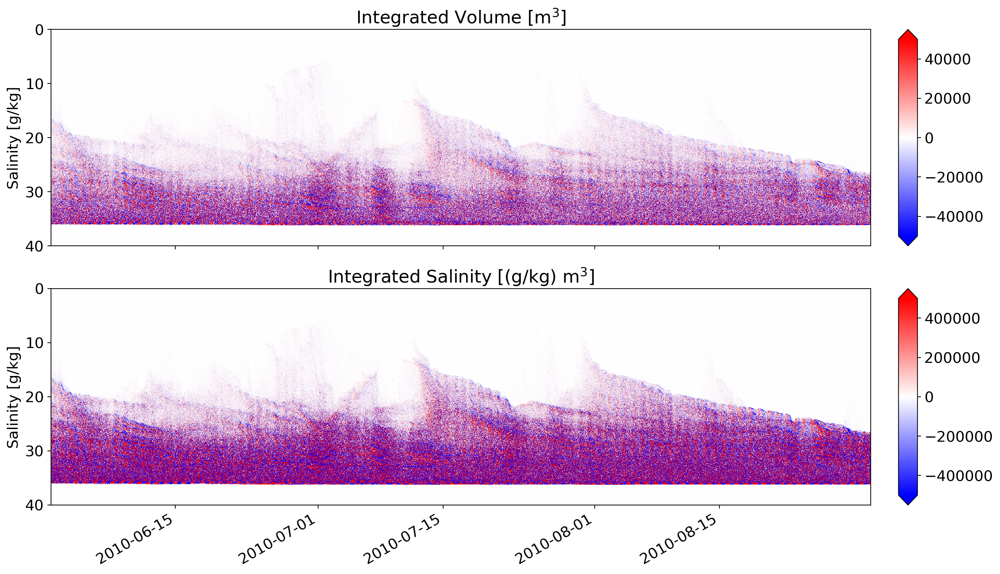

In [35]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

dVdts.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 50000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

dVsdts.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 500000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Integrated Volume [m$^3$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Integrated Salinity [(g/kg) m$^3$]')
ax[1].set_ylabel('Salinity [g/kg]')

In [4]:
tefslice = tef.sel(ocean_time = slice('2010-06', '2010-08'))

In [5]:
Qe = tefslice.Qnet-dVdts
Qes = tefslice.Qsnet-dVsdts

Text(0, 0.5, 'Salinity [g/kg]')

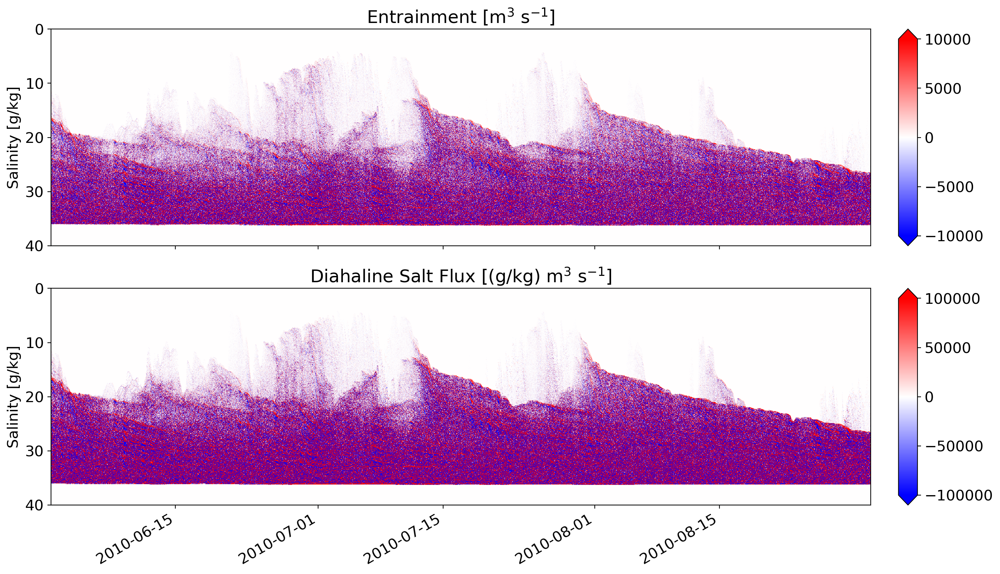

In [82]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

Qe.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 10000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

Qes.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 100000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Diahaline Salt Flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].set_ylabel('Salinity [g/kg]')

### So the time-salinity plots of entrainment and diahaline salt flux look noisy - which is expected. What about salinity coordiantes?

In [6]:
ds = tefslice.salt_bin[1]-tefslice.salt_bin[0]
dQds = tefslice.Qnet.diff('salt_bin')/ds

In [7]:
chislice = chi.sel(ocean_time = slice('2010-06', '2010-08'))

Text(0.5, 1.0, '$\\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

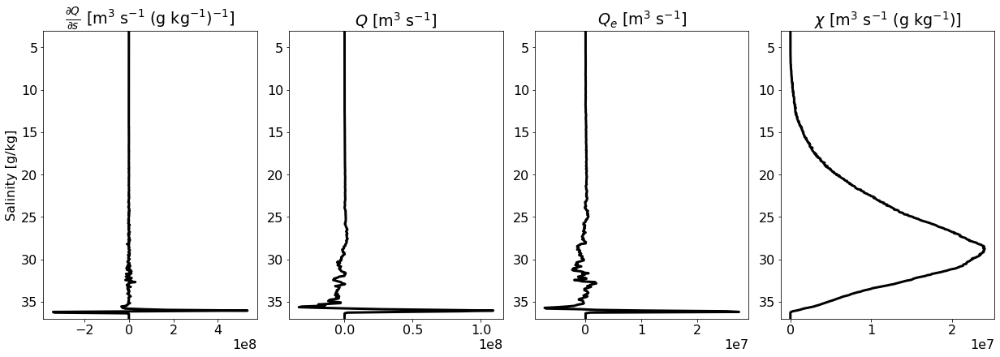

In [83]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (17,6), constrained_layout = True)

dQds.sum('ocean_time').plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

tef.Qnet.sum('ocean_time').plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'$Q$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Qe.sum('ocean_time').plot(ax = ax[2], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[2].set_ylabel('')

chislice.sum('ocean_time').plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
ax[3].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')


Text(0.5, 1.0, 'Normalized $\\chi$')

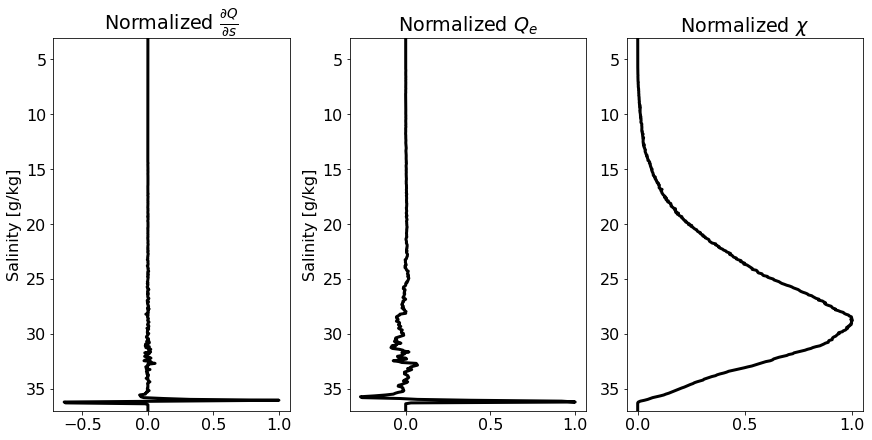

In [84]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,3 ,figsize = (12,6), constrained_layout = True)

dQdsnorm = (dQds.sum('ocean_time')/(dQds.sum('ocean_time').max()))
dQdsnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $\frac{\partial Q}{\partial s}$')
ax[0].set_ylabel('Salinity [g/kg]')

Qenorm = (Qe.sum('ocean_time')/(Qe.sum('ocean_time').max()))
Qenorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Normalized $Q_e$')
ax[1].set_ylabel('Salinity [g/kg]')

chinorm = (chislice.sum('ocean_time')/(chislice.sum('ocean_time').max()))
chinorm.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')
ax[2].set_title('Normalized $\chi$')


Text(0, 0.5, 'Salinity [g/kg]')

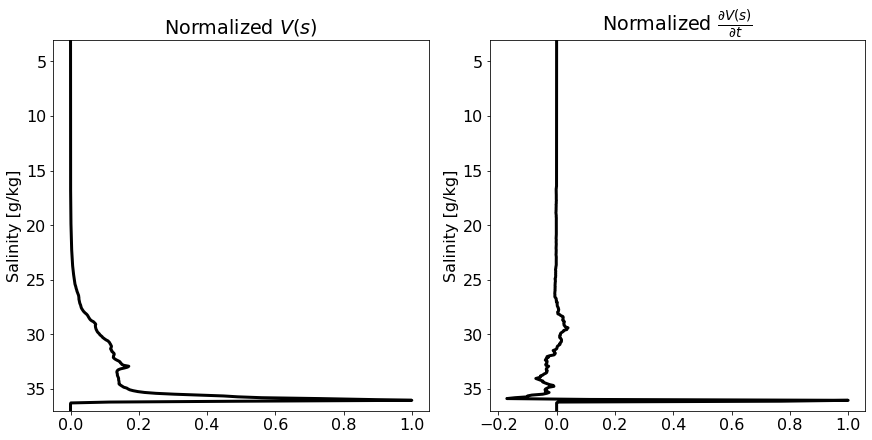

In [90]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,2 ,figsize = (12,6), constrained_layout = True)

dVnorm = (volhists.dV_saltcoord.sum('ocean_time')/(volhists.dV_saltcoord.sum('ocean_time').max()))
dVnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $V(s)$')
ax[0].set_ylabel('Salinity [g/kg]')

dVdtsnorm = (dVdts.sum('ocean_time')/(dVdts.sum('ocean_time').max()))
dVdtsnorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'Normalized $\frac{\partial V(s)}{\partial t}$')
ax[1].set_ylabel('Salinity [g/kg]')



Text(0, 0.5, 'Salinity [g/kg]')

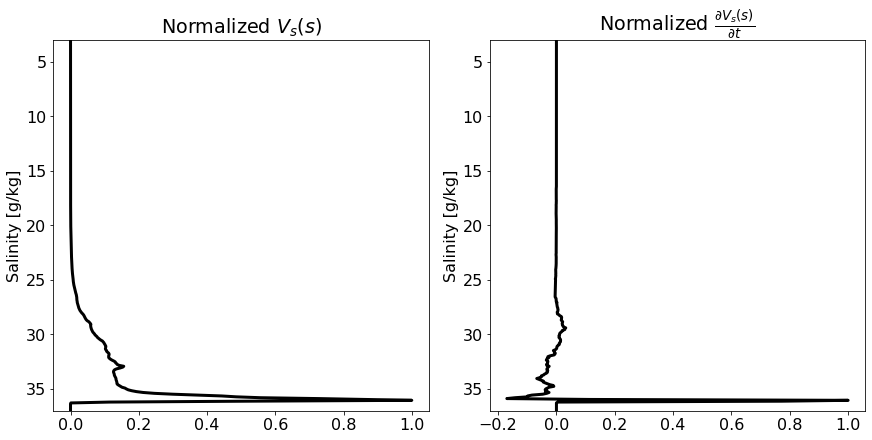

In [91]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,2 ,figsize = (12,6), constrained_layout = True)

dVsnorm = (volhists.dVs_saltcoord.sum('ocean_time')/(volhists.dVs_saltcoord.sum('ocean_time').max()))
dVsnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $V_s(s)$')
ax[0].set_ylabel('Salinity [g/kg]')

dVsdtsnorm = (dVsdts.sum('ocean_time')/(dVsdts.sum('ocean_time').max()))
dVsdtsnorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'Normalized $\frac{\partial V_s(s)}{\partial t}$')
ax[1].set_ylabel('Salinity [g/kg]')



### Calculate the integral relationships first. 

In [183]:
(Qe.sum('ocean_time')-Qeint)

<xarray.DataArray (salt_bin: 499)>
dask.array<sub, shape=(499,), dtype=float64, chunksize=(499,), chunktype=numpy.ndarray>
Coordinates:
  * salt_bin  (salt_bin) float64 0.12 0.2 0.28 0.36 ... 39.72 39.8 39.88 39.96

In [9]:
rhs = ((tefslice.Qnet[1:].sum('ocean_time')-dVdts.sum('ocean_time')).diff('salt_bin'))/ds

Text(0.5, 0, '[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')

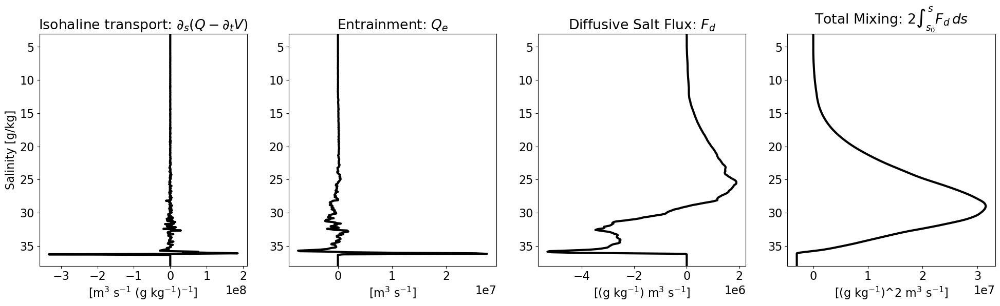

In [53]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (24,6), dpi = 100)

(rhs).plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
# ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

Qeint = ((rhs*ds)).cumsum('salt_bin')
Qeint.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
# ax[1].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Fmint = (Qeint*ds).cumsum('salt_bin')
Fmint.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')

resmix = 2*((Fmint*ds).cumsum('salt_bin'))
resmix.plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
# ax[2].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

ax[0].set_title(r'Isohaline transport: $\partial_s (Q- \partial_t V)$')
ax[1].set_title('Entrainment: $Q_e$')
ax[2].set_title(r'Diffusive Salt Flux: $F_d$')
ax[3].set_title(r'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

ax[0].set_xlabel(r'[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[1].set_xlabel('[m$^3$ s$^{-1}$]')
ax[2].set_xlabel('[(g kg$^{-1}$) m$^3$ s$^{-1}$]')
ax[3].set_xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')


Text(0.5, 1.0, 'Mixing comparison')

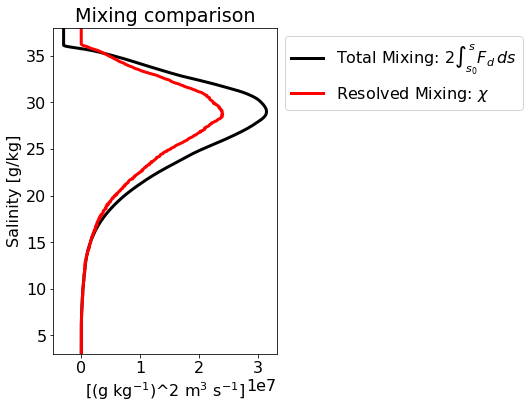

In [193]:
fig = plt.subplots(1, figsize = (4,6))

resmix.plot(y = 'salt_bin', 
            ylim = (3,38),
            c = 'k',
            lw = 3,
            label = 'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

chislice[1:].sum('ocean_time').plot(y = 'salt_bin', 
                                    ylim = (3,38),
                                    c = 'r',
                                    lw = 3,
                                    label = 'Resolved Mixing: $\chi$')


plt.legend(bbox_to_anchor=(1.0, 1.00))
plt.xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')
plt.ylabel('Salinity [g/kg]')
plt.title('Mixing comparison')

In [196]:
resmix[-1].values

array(-2996529.22842233)

### Redo the integral relationships, but leave the time dimension for instantaneous comparison.

In [13]:
rhs1 = ((tefslice.Qnet[1:]-dVdts).diff('salt_bin'))/ds

Qeint1 = ((rhs1*ds)).cumsum('salt_bin')

Fmint1 = (Qeint1*ds).cumsum('salt_bin')

resmix1 = 2*((Fmint1*ds).cumsum('salt_bin'))

### First - check the salinity variance budget and see how using the total mixing compares

In [ ]:
fig = plt.subplots(1, figsize = (8,4), dpi = 100)
# chislice.sum('salt_bin')
# resmix1[:,:430].sum('salt_bin')
(tefslice.svaradv[1:]-chislice[1:].sum('salt_bin')).plot(lw=2, color='k', label=r'$Q_{in}s \prime^2_{in}+Q_{out}s \prime^2_{out}-\chi$')
# (tef.ssaltadv).plot(lw=2, color='r', label=r'$Q_{in}s^2_{in}+Q_{out}s^2_{out}$')
storageslice.dsvardt[1:].plot(lw=2, color='r', label=r'$\frac{\partial (s \prime^2V)}{\partial t}$')
# chi_hourly.chi.plot(lw = 1.5, color = 'c', label = '$\chi$')

plt.xlabel('')
plt.ylabel(r'[psu$^2 m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.5, 1.05))
plt.title('Salt Variance Budget - No Surface Forcing')

In [303]:
(storageslice.dVdt.sum()-tefslice.voladv.sum())/(storageslice.dVdt.sum()).values*100

<xarray.DataArray ()>
array(-1.1407627)

Text(0.5, 1.0, 'Volume Budget - No Surface Forcing')

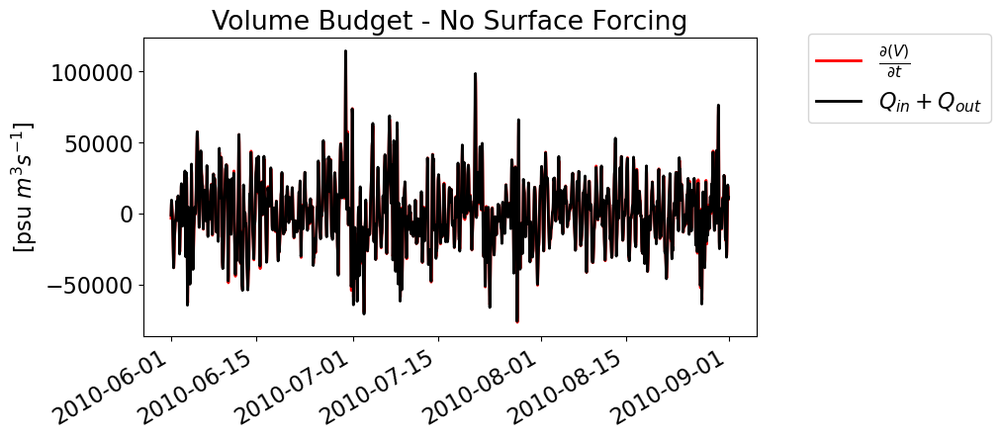

In [297]:
fig = plt.subplots(1, figsize = (8,4), dpi=100)

(storageslice.dVdt).plot(lw=2, color='r', label=r'$\frac{\partial (V)}{\partial t}$')
(tefslice.voladv).plot(lw=2, color='k', label = r'$Q_{in}+Q_{out}$')

plt.xlabel('')
plt.ylabel(r'[psu $m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.4, 1.05))
plt.title('Volume Budget - No Surface Forcing')

Text(0.5, 1.0, 'Salt Variance Budget - No Surface Forcing')

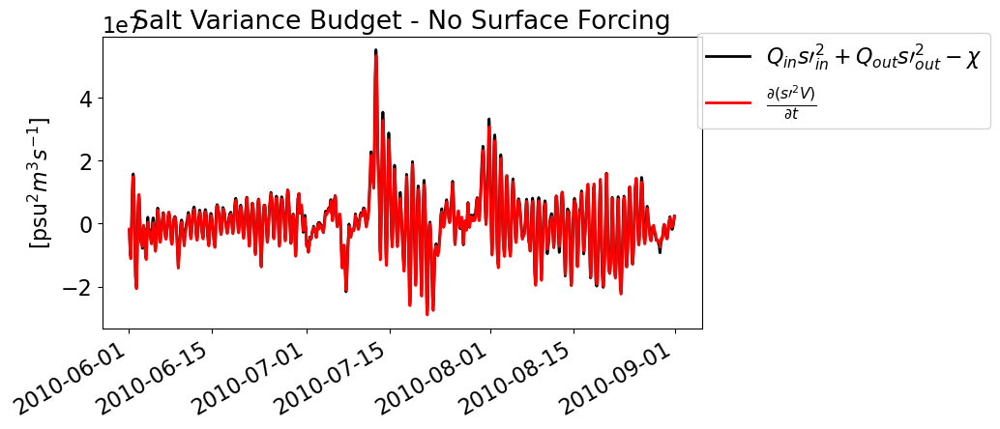

In [263]:
storageslice = storage.sel(ocean_time = slice('2010-06', '2010-08'))


fig = plt.subplots(1, figsize = (8,4), dpi = 100)
# chislice.sum('salt_bin')
# resmix1[:,:430].sum('salt_bin')
(tefslice.svaradv[1:]-chislice[1:].sum('salt_bin')).plot(lw=2, color='k', label=r'$Q_{in}s \prime^2_{in}+Q_{out}s \prime^2_{out}-\chi$')
# (tef.ssaltadv).plot(lw=2, color='r', label=r'$Q_{in}s^2_{in}+Q_{out}s^2_{out}$')
storageslice.dsvardt[1:].plot(lw=2, color='r', label=r'$\frac{\partial (s \prime^2V)}{\partial t}$')
# chi_hourly.chi.plot(lw = 1.5, color = 'c', label = '$\chi$')

plt.xlabel('')
plt.ylabel(r'[psu$^2 m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.5, 1.05))
plt.title('Salt Variance Budget - No Surface Forcing')

In [295]:
(tefslice.svaradv[1:]-(resmix1[:,:440].sum('salt_bin'))).sum().values

array(-3.32631861e+08)

In [275]:
chislice[1:].sum().values

array(3.11690603e+09)

In [265]:
storageslice.dsvardt[1:].sum().values

array(-4.53129998e+08)

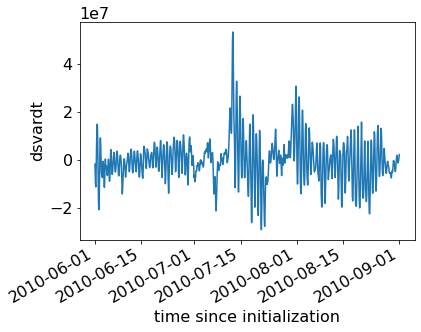

In [235]:
storageslice.dsvardt[1:].plot()

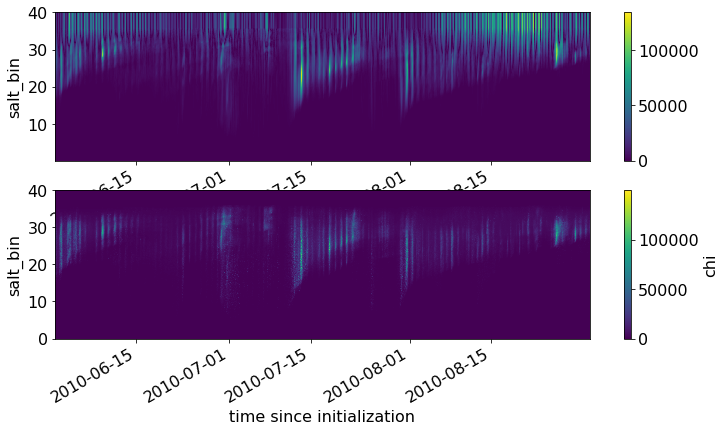

In [14]:
fig, ax = plt.subplots(2,1, figsize = (12,6))
np.abs(resmix1).plot(y = 'salt_bin', ax = ax[0])

chislice[1:].plot(y = 'salt_bin', ax = ax[1])

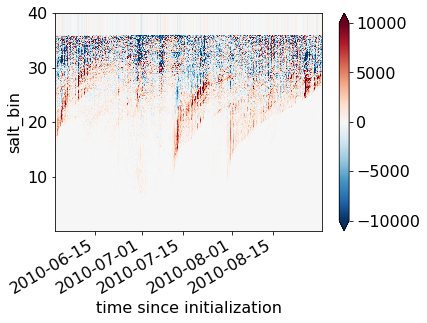

In [222]:
Fmint1.plot(vmax = 10000, y = 'salt_bin')

In [42]:
Qeint1

<xarray.DataArray (ocean_time: 2207, salt_bin: 480)>
dask.array<nancumsum, shape=(2207, 480), dtype=float64, chunksize=(2207, 480), chunktype=numpy.ndarray>
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-06-01T01:00:00 ... 2010-08-3...
  * salt_bin    (salt_bin) float64 0.12 0.2 0.28 0.36 ... 38.2 38.28 38.36 38.44

In [45]:
rhs1 = ((tefslice.Qnet[1:]-dVdts).diff('salt_bin'))/ds

Qeint1 = ((rhs1[:,:]*ds)).cumsum('salt_bin')

Fmint1 = (Qeint1*ds).cumsum('salt_bin')

resmix1 = 2*((Fmint1*ds).cumsum('salt_bin'))

Text(0, 0.5, 'Salinity [g/kg]')

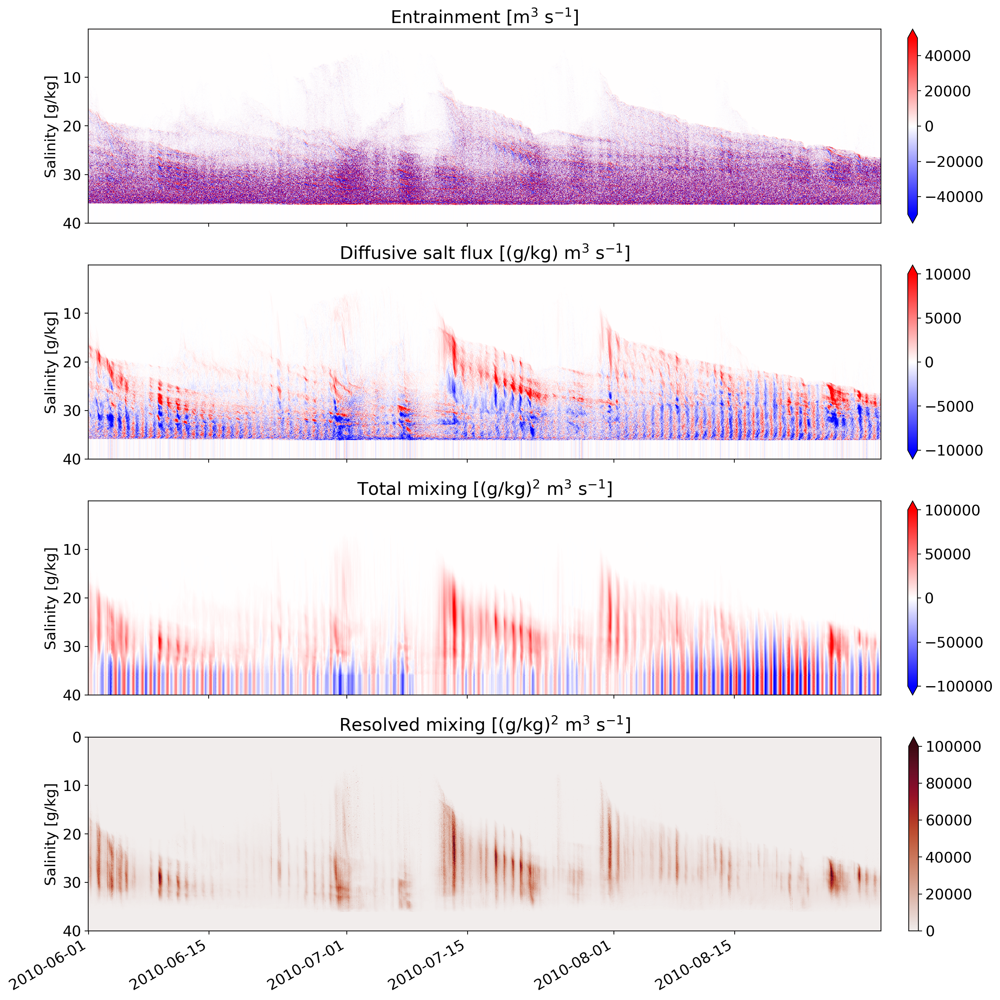

In [57]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(4, figsize = (14,14), constrained_layout = True, dpi = 200)

Qeint1.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 50000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

Fmint1.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 10000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

resmix1.plot(ax = ax[2],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 100000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

chislice.plot(ax = ax[3],
             y = 'salt_bin', 
             cmap = cmo.amp,
             vmax = 100000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Diffusive salt flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].set_ylabel('Salinity [g/kg]')
ax[1].axes.xaxis.set_ticklabels([])

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_title('Total mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[2].set_ylabel('Salinity [g/kg]')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_title('Resolved mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[3].set_ylabel('Salinity [g/kg]')

In [28]:
Qeint[:450]

<xarray.DataArray (salt_bin: 450)>
dask.array<getitem, shape=(450,), dtype=float64, chunksize=(450,), chunktype=numpy.ndarray>
Coordinates:
  * salt_bin  (salt_bin) float64 0.12 0.2 0.28 0.36 ... 35.8 35.88 35.96 36.04

Text(0.5, 0, '[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')

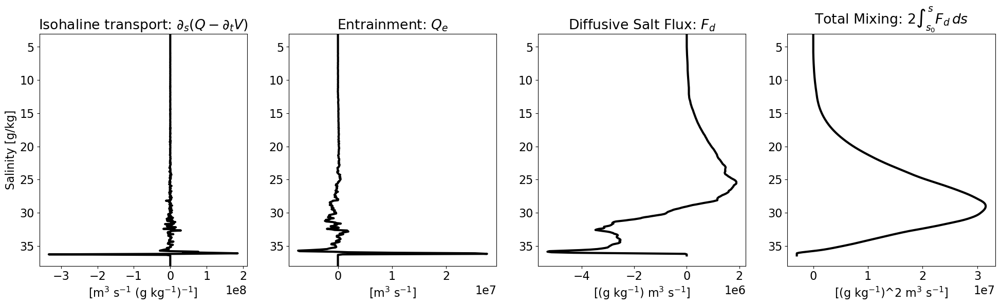

In [33]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (24,6), dpi = 100)

(rhs).plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
# ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

Qeint = ((rhs*ds)).cumsum('salt_bin')
Qeint.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
# ax[1].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Fmint = (Qeint*ds)[:455].cumsum('salt_bin')
Fmint.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')

resmix = 2*((Fmint*ds).cumsum('salt_bin'))
resmix.plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
# ax[2].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

ax[0].set_title(r'Isohaline transport: $\partial_s (Q- \partial_t V)$')
ax[1].set_title('Entrainment: $Q_e$')
ax[2].set_title(r'Diffusive Salt Flux: $F_d$')
ax[3].set_title(r'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

ax[0].set_xlabel(r'[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[1].set_xlabel('[m$^3$ s$^{-1}$]')
ax[2].set_xlabel('[(g kg$^{-1}$) m$^3$ s$^{-1}$]')
ax[3].set_xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')
